In [2]:
import numpy as np
import matplotlib.pyplot as plt


In [3]:
""" Data Extraction for Training Set"""
x_train= []
y_train = []
with open('Dataset_2_train.csv','r') as file:
    lines = file.readlines()
    for l in lines:
            lread = l.split(',')
            x_train.append(float(lread[0]))
            y_train.append(float(lread[1]))
    
np.set_printoptions(precision=10)
x_train = np.matrix(x_train, dtype= np.float)
x_train = x_train.transpose()
x_train = np.insert(x_train, 0, 1, axis = 1)
y_train = np.matrix(y_train, dtype= np.float)
y_train = y_train.transpose()

In [4]:
""" Data Extraction For Validation Set"""
x_val = []
y_val = []
with open('Dataset_2_valid.csv','r') as file:
    lines = file.readlines()
    for l in lines:
        lread = l.split(',')
        x_val.append(float(lread[0]))
        y_val.append(float(lread[1]))
        
np.set_printoptions(precision=10)
x_val = np.matrix(x_val, dtype= np.float)
x_val = x_val.transpose()
x_val = np.insert(x_val, 0, 1, axis = 1)
y_val = np.matrix(y_val, dtype= np.float)
y_val = y_val.transpose()

In [5]:
""" Finding Y_hat """
def calculate_y_hat (x_train , w_hat):
    y_hat = np.dot(x_train , w_hat)
    return(y_hat)

In [6]:
""" Finding Mean_Square_Error (MSE) """
def calculate_MSE (y_hat, y_train):
    subtract = np.subtract(y_hat , y_train)
    squared = np.power(subtract[:,0], 2)
    add = squared.sum(axis = 0)
    MSE = np.divide(add, 50)
    return(MSE)

In [7]:
""" Generating Random w_0 and w_1 """
np.set_printoptions(precision=10)
w_0 = np.random.rand()
w_1 = np.random.rand()
w_hat = []
MSE_val_epoch = []
MSE_train_epoch = []

In [8]:
""" Step Size inialization """
alpha = 0.000001


In [9]:
MSE_val_epoch = []
MSE_train_epoch = []
for epoch in range (0 , 10000):
    
    for ind in range(0 , 300):
        x_new = x_train[(ind , 1 )]
        y_new = y_train [(ind , 0)]
        y_1 = np.multiply(w_1 , x_new)
        y_hat = np.add(w_0 , y_1)
        gradient_1 = np.multiply(alpha , (np.subtract(y_hat , y_new)))
        w_0 = np.subtract(w_0 , gradient_1)
        gradient_2 = np.multiply(gradient_1 , x_new)
        w_1 = np.subtract(w_1 , gradient_2)
        w_hat = [w_0 , w_1]
    
    
    """ Calculating MSE for Train  """    
    y_hat_train = calculate_y_hat (x_train , w_hat)
    MSE_train = calculate_MSE (y_hat_train, y_train)
    MSE_train_epoch.append(MSE_train)

    
    
    """ Calculating Validation MSE """
    y_hat_val = calculate_y_hat (x_val , w_hat)    
    MSE_val = calculate_MSE (y_hat_val, y_val)
    MSE_val_epoch.append(MSE_val)


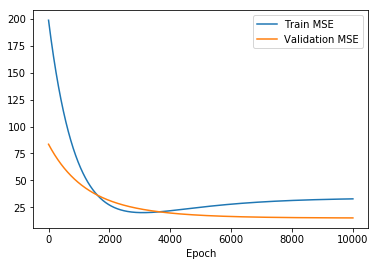

In [10]:
a = np.array(MSE_train_epoch).squeeze()
b = np.array(MSE_val_epoch).squeeze()
plt.plot (range(len(a)) , a, label = 'Train MSE')
plt.plot (range(len(b)) , b, label = 'Validation MSE')
plt.legend(loc ='upper right')
plt.xlabel('Epoch')
plt.show()    

In [11]:
alpha_new = [0.01 , 0.001, 0.0001, 0.00001, 0.000001, 0.0000001]
info = []


for alpha in alpha_new:
    w_0 = np.random.rand()
    w_1 = np.random.rand()
    
    for epoch in range (0 , 5000):

        for ind in range(0 , 300):
            x_new = x_train[(ind , 1 )]
            y_new = y_train [(ind , 0)]
            y_1 = np.multiply(w_1 , x_new)
            y_hat = np.add(w_0 , y_1)
            gradient_1 = np.multiply(alpha , (np.subtract(y_hat , y_new)))
            w_0 = np.subtract(w_0 , gradient_1)
            gradient_2 = np.multiply(gradient_1 , x_new)
            w_1 = np.subtract(w_1 , gradient_2)
            w_hat = [w_0 , w_1]


    """ Calculating MSE for Train  """    
    y_hat_train = calculate_y_hat (x_train , w_hat)
    MSE_train = calculate_MSE (y_hat_train, y_train)



    """ Calculating Validation MSE """
    y_hat_val = calculate_y_hat (x_val , w_hat)
    MSE_val = calculate_MSE (y_hat_val, y_val)
    
    print('Step Size:',alpha,'Train MSE:',MSE_train,'Validation MSE:',MSE_val)
    info.append([alpha,MSE_train,MSE_val,w_hat])


Step Size: 0.01 Train MSE: [[ 35.5883976781]] Validation MSE: [[ 16.0890754243]]
Step Size: 0.001 Train MSE: [[ 35.3049503315]] Validation MSE: [[ 16.1830542841]]
Step Size: 0.0001 Train MSE: [[ 35.2521574065]] Validation MSE: [[ 16.1983319813]]
Step Size: 1e-05 Train MSE: [[ 34.2559124505]] Validation MSE: [[ 15.3658841678]]
Step Size: 1e-06 Train MSE: [[ 23.8678580314]] Validation MSE: [[ 16.2904652706]]
Step Size: 1e-07 Train MSE: [[ 106.935713527]] Validation MSE: [[ 57.1573544194]]


In [12]:
print (MSE_val.dtype)

float64


In [13]:
for i in info:
    print(i)

[0.01, matrix([[ 35.5883976781]]), matrix([[ 16.0890754243]]), [3.5892327651089193, 4.3247691957865335]]
[0.001, matrix([[ 35.3049503315]]), matrix([[ 16.1830542841]]), [3.5783458717913414, 4.321376026563466]]
[0.0001, matrix([[ 35.2521574065]]), matrix([[ 16.1983319813]]), [3.5767076931179913, 4.3203873631282068]]
[1e-05, matrix([[ 34.2559124505]]), matrix([[ 15.3658841678]]), [3.7383299703258293, 4.1311825032089047]]
[1e-06, matrix([[ 23.8678580314]]), matrix([[ 16.2904652706]]), [3.8285543265016577, 3.3992659282217623]]
[1e-07, matrix([[ 106.935713527]]), matrix([[ 57.1573544194]]), [1.4465712149705106, 1.4390521971954853]]


In [14]:
w_best = info [3][3]
alpha_best = info [3][0]
print ('Best W:',  w_best)
print('Best Alpha:',alpha_best)

Best W: [3.7383299703258293, 4.1311825032089047]
Best Alpha: 1e-05


In [15]:
""" Data Extraction for Test Set"""
x_test= []
y_test = []
with open('Dataset_2_test.csv','r') as file:
    lines = file.readlines()
    for l in lines:
            lread = l.split(',')
            x_test.append(float(lread[0]))
            y_test.append(float(lread[1]))
    
np.set_printoptions(precision=10)
x_test = np.matrix(x_test, dtype= np.float)
x_test = x_test.transpose()
x_test = np.insert(x_test, 0, 1, axis = 1)
y_test = np.matrix(y_test, dtype= np.float)
y_test = y_test.transpose()

In [16]:
y_hat_test = calculate_y_hat (x_test , w_best)
MSE_test = calculate_MSE (y_hat_test, y_test)
print ('Test MSE:',MSE_test)

Test MSE: [[ 15.8129010426]]


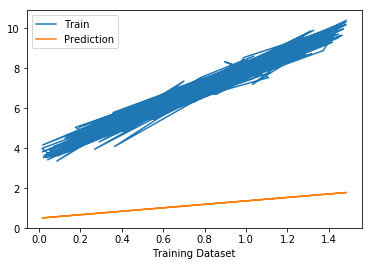

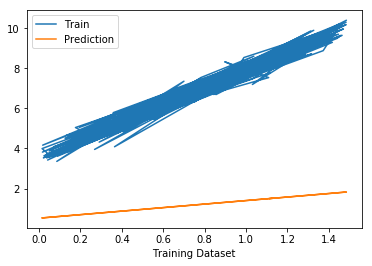

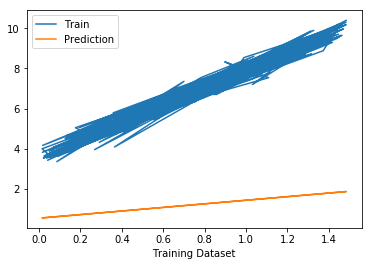

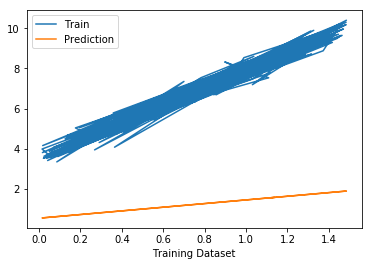

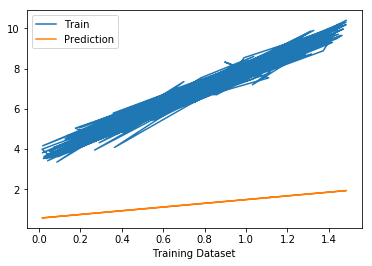

...

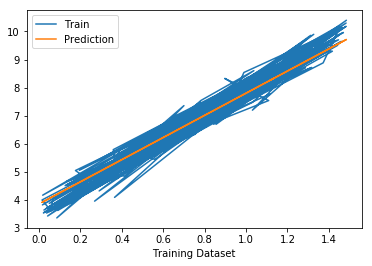

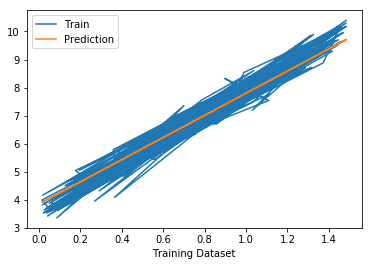

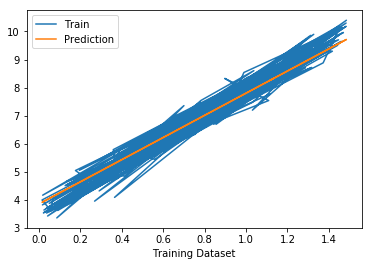

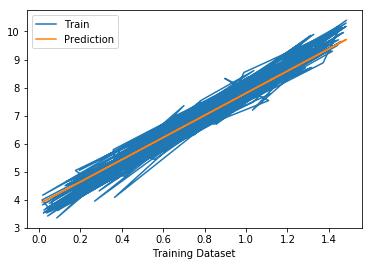

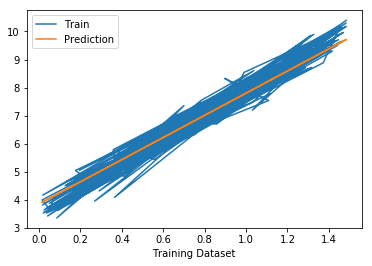

In [17]:
""" Visualize the Fit for Every Epoch"""
w_0 = np.random.rand()
w_1 = np.random.rand()
alpha = alpha_best
for epoch in range (0 , 1000):
    
    for ind in range(0 , 300):
        x_new = x_train[(ind , 1 )]
        y_new = y_train [(ind , 0)]
        y_1 = np.multiply(w_1 , x_new)
        y_hat = np.add(w_0 , y_1)
        gradient_1 = np.multiply(alpha , (np.subtract(y_hat , y_new)))
        w_0 = np.subtract(w_0 , gradient_1)
        gradient_2 = np.multiply(gradient_1 , x_new)
        w_1 = np.subtract(w_1 , gradient_2)
        w_hat = [w_0 , w_1]
    
    
    
    y_hat_train = calculate_y_hat (x_train , w_hat)  

    plt.plot(x_train[:,1], y_train, label = 'Train')
    plt.plot(x_train[:,1], y_hat_train.T, label = 'Prediction')
    plt.legend(loc ='upper left')
    plt.xlabel('Training Dataset')
    plt.show()